<b>Student Name:</b> Vrushali Atul Surve<br>
<b>Student ID:</b> x19212712<br>
<b>Student Email ID:</b> x19212712@student.ncirl.ie <br>
<b>Subject:</b>Database and Analytics Programming<br>
<b>Lecturer:</b> Athanasios Staikopoulos<br>
<b>College:</b> National College of Ireland

<h1><center>Starbucks Location Analysis</center></h1>

![alt text](https://www.freepnglogos.com/uploads/starbucks-logo-png-1.png)

In this Notebok, I will investigate the Starbucks Store catalog in look for answers to following question.
<b>
* What country or city has the most Starbucks?
* We will likewise investigate the inquiry on the contrast between a Starbucks at Target and a Franchise-Store Starbucks
* What number of each kind are there? <br> </b> At last, we will end our investigation, by plotting each store on a Map utilizing folium <br>

### A Brief History of Starbucks

Initially founded by Jerry Baldwin, Zev Siegl, and Gordon Bowker in 1971, Starbucks opened its first store at 1912 Pike's Place in Seattle, Washington. The future CEO, Howard Schultz joined with the young company in 1982 as the Director of Retail Operations & Marketing. In 1983, Schultz took his revolutionary trip across Italy, where fell in love with the concept of a "coffeehouse". Returning to the United States at the beginning of 1984, he explains the coffeehouse concept to the owner's, and convinces them to give it a try. The first Cafe Latte was sold later that year. After the coffeehouse experiment's success, Shultz stepped away from Starbuck's and founded II Giornale ,"The Jounal". 

From 1985-1987, Il Giornale grew substantially, and at the end of 1987 acquired the Starbuck's shop on Pike's Place. The acquisition then formed, what we know today as the Starbuck's Corporation. Before the end of 1987, there were 17 Starbucks Coffeehouses in cities such as Chicago, Vancouver, and Seattle. In 30 years, Starbuck's went from only 33 stores in 1988 to 25,600 stores worldwide.

### Analysis Apporach 
Here I used PPDAC Apporach for my analysis <br>
A cycle that is used to carry out a statistical investigation. The cycle consists of five stages: Problem, Plan, Data, Analysis, Conclusion. The cycle is sometimes abbreviated to the PPDAC cycle.
<b>
* The problem section is about formulating a statistical question, what data to collect, who to collect it from and why it is important.
* The plan section is about how the data will be gathered.
* The data section is about how the data is managed and organised.
* The analysis section is about exploring and analysing the data, using a variety of data displays and numerical summaries, and reasoning with the data.
</b>
The conclusion section is about answering the question in the problem section and giving reasons based on the analysis section.

<br>

![alt text](http://optimumsportsperformance.com/blog/wp-content/uploads/2019/12/Screen-Shot-2019-12-14-at-8.44.49-PM-624x369.png)

### Analysis Steps are as follows:
<br>
<b>
    1. Data Collection <br>
    2. Storing of Data in MongoDB <br>
    3. Retriving Data from MongoDB for further analysis <br>
    4. Data Exploration and Preparation <br>
    5. Missing Value Treatment <br>
    6. Data Visualisation <br>
    7. Results and Conclusions <br>
    8. Storing Data in SQL Database <br>
</b>

### 1. Importing required libraries

Libraries are collection of modules. We can use these modules to perform our task. Here we will import all the required libraries which will be used in the project.

In [203]:
import json
import folium
import sqlite3
import warnings
import matplotlib
import mysql.connector
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from pymongo import MongoClient
from mysql.connector import Error
pd.set_option('mode.chained_assignment', None)
warnings.filterwarnings("ignore")

### 2. The Starbucks Store Directory

This directory contains the records of 26,000 plus Starbuck stores along with some additional information. Let's begin the exploration by reading in the file and viewing what information is available. 

In [35]:
file_path = r".\directory.csv" # Store file path in a variable
store_data = pd.read_csv(file_path) # Store csv file to Dataframe
store_data.head(5) # Check for DataFrame and Data

,Brand,Store Number,Store Name,Ownership Type,Street Address,City,State/Province,Country,Postcode,Phone Number,Timezone,Longitude,Latitude
0,Starbucks,47370-257954,"Meritxell, 96",Licensed,"Av. Meritxell, 96",Andorra la Vella,7,AD,AD500,376818720,GMT+1:00 Europe/Andorra,1.53,42.51
1,Starbucks,22331-212325,Ajman Drive Thru,Licensed,"1 Street 69, Al Jarf",Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.42
2,Starbucks,47089-256771,Dana Mall,Licensed,Sheikh Khalifa Bin Zayed St.,Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.39
3,Starbucks,22126-218024,Twofour 54,Licensed,Al Salam Street,Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.38,24.48
4,Starbucks,17127-178586,Al Ain Tower,Licensed,"Khaldiya Area, Abu Dhabi Island",Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.54,24.51


In [36]:
store_data.info() # Checking number of records and Data Types in the columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25600 entries, 0 to 25599
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Brand           25600 non-null  object 
 1   Store Number    25600 non-null  object 
 2   Store Name      25600 non-null  object 
 3   Ownership Type  25600 non-null  object 
 4   Street Address  25598 non-null  object 
 5   City            25585 non-null  object 
 6   State/Province  25600 non-null  object 
 7   Country         25600 non-null  object 
 8   Postcode        24078 non-null  object 
 9   Phone Number    18739 non-null  object 
 10  Timezone        25600 non-null  object 
 11  Longitude       25599 non-null  float64
 12  Latitude        25599 non-null  float64
dtypes: float64(2), object(11)
memory usage: 2.5+ MB


### 3. Storing the DataFrame in MongoDB

To store the dataframe in the mongoDB database we declare a function <b>csv_to_json</b>. This function takes the dataframe and store the datframe to mongoDB database within an collection named <b>location</b>

In [38]:
db = MongoClient("mongodb://localhost:27017/") # Creates a connection on localhost mongoDB with ports 27017

def csv_to_json(filename, header=None):
    """This function converts the DataFrame(csv) into dictonary(document format[json]) which help to store the in MongoDB. 
    
    data: stores dataframe
    """
    data = pd.read_csv(filename, header=header)
    return data.to_dict('records')

# Storing Data in twitter_database in location collection 
db.twitter_database.location.insert_many(csv_to_json(file_path, header=0)) 

print("Your CSV file has been imported successfully in 'twitter_database' in 'location' collection")

Your CSV file has been imported successfully in 'twitter_database' in 'location' collection


### 4. Retrieving data from MongoDB

Now, we retrive the data from MongoDB database for our further Data Preprocessing, Analysis and Visualization

In [43]:
"""" Extract the data from collection name location fro further analysis.
collection: Store collection named loction from mongoDB
store: Find all the documents present in the collection
store_dict: Create an empty directory
store_df: Store documents as Dataframe from store variables
""""

collection = db.twitter_database["location"]
store = collection.find()
store_dict = {}
store_df = pd.DataFrame(list(store))

In [44]:
print(store_df.head(3)) # Checking retrived from the database

                        _id      Brand  Store Number        Store Name  \
0  6084baace5cc4cee78aeed21  Starbucks  47370-257954     Meritxell, 96   
1  6084baace5cc4cee78aeed22  Starbucks  22331-212325  Ajman Drive Thru   
2  6084baace5cc4cee78aeed23  Starbucks  47089-256771         Dana Mall   

  Ownership Type                Street Address              City  \
0       Licensed             Av. Meritxell, 96  Andorra la Vella   
1       Licensed          1 Street 69, Al Jarf             Ajman   
2       Licensed  Sheikh Khalifa Bin Zayed St.             Ajman   

  State/Province Country Postcode Phone Number                 Timezone  \
0              7      AD    AD500    376818720  GMT+1:00 Europe/Andorra   
1             AJ      AE      NaN          NaN     GMT+04:00 Asia/Dubai   
2             AJ      AE      NaN          NaN     GMT+04:00 Asia/Dubai   

   Longitude  Latitude  
0       1.53     42.51  
1      55.47     25.42  
2      55.47     25.39  


### 5. Create New Dataframe with only required columns

Here, we will create a dataframe where we can take only required columns on which we need to do preprocessing, analysis and Visualization 

In [62]:
new_store_df = store_df[["Store Number","Store Name","Ownership Type","Street Address","City","State/Province",
                         "Country","Postcode","Phone Number","Timezone","Longitude","Latitude"]]

In [63]:
"""Renaming these to eliminate further errors in white spaces, camel case, etc

new_store_df: Store renamed dataframe 
"""
new_store_df = new_store_df.rename(columns={"Store Number":"store_number","Store Name":"store_name",
                                                      "Ownership Type":"ownership_type","Street Address":"street_address",
                                                      "City":"city", "State/Province": "state_province", "Country":"country",
                                                      "Postcode": "postcode", "Phone Number": "phone_number",
                                                      "Timezone":"timezone","Longitude":"longitude","Latitude":"latitude"})

In [64]:
new_store_df.info() # Checking number of records and Data Types in the columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25600 entries, 0 to 25599
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   store_number    25600 non-null  object 
 1   store_name      25600 non-null  object 
 2   ownership_type  25600 non-null  object 
 3   street_address  25598 non-null  object 
 4   city            25585 non-null  object 
 5   state_province  25600 non-null  object 
 6   country         25600 non-null  object 
 7   postcode        24078 non-null  object 
 8   phone_number    18739 non-null  object 
 9   timezone        25600 non-null  object 
 10  longitude       25599 non-null  float64
 11  latitude        25599 non-null  float64
dtypes: float64(2), object(10)
memory usage: 2.3+ MB


### 6. Merging two Dataframes to Create One
Looking at the <b>"country"</b> column, it can be only found country code has been defined. To avoid a bit of confusion in the names of the countries we can merge the data frame with another dataframe that contains country code and country names. For this we will be using <b>merge</b> function from pandas and create an additional column name <b>"country_name"</b>

In [93]:
"""Calling the countries dataframe and storing into the variable named "country_name"

country_name: Store countries csv in dataframe format
"""
country_name = pd.read_csv(r'.\countries.csv', names=['country_name', 'code'])
country_name.head(5)

,country_name,code
NaN,country_name,code
1.0,Afghanistan,AF
2.0,Albania,AL
3.0,Algeria,DZ
4.0,American Samoa,AS


In [94]:
"""By using merge function we can join to dataframes. Here I have joined on country and code columns.

new_store_df: Merging two dataframes and storing as one
"""
new_store_df = new_store_df.merge(countries, left_on='country', right_on='code')
new_store_df.drop('code', axis=1, inplace=True)
new_store_df.head(5)

,store_number,store_name,ownership_type,street_address,city,state_province,country,postcode,phone_number,timezone,longitude,latitude,country_name
0,47370-257954,"Meritxell, 96",Licensed,"Av. Meritxell, 96",Andorra la Vella,7,AD,AD500,376818720,GMT+1:00 Europe/Andorra,1.53,42.51,Andorra
1,22331-212325,Ajman Drive Thru,Licensed,"1 Street 69, Al Jarf",Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.42,United Arab Emirates (the)
2,47089-256771,Dana Mall,Licensed,Sheikh Khalifa Bin Zayed St.,Ajman,AJ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,55.47,25.39,United Arab Emirates (the)
3,22126-218024,Twofour 54,Licensed,Al Salam Street,Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.38,24.48,United Arab Emirates (the)
4,17127-178586,Al Ain Tower,Licensed,"Khaldiya Area, Abu Dhabi Island",Abu Dhabi,AZ,AE,NaN,NaN,GMT+04:00 Asia/Dubai,54.54,24.51,United Arab Emirates (the)


### 7. Now let's explore the completeness of the directory

To do this, let us declare a function that will come in handy across several different proceeding questions. This function takes an object and a function as inputs and calculates the respective percents arising from the passed function. 

In [56]:
def percentage(obj,func,agg=False,rnd=2):
    
    """This function calculates the aggregated or disaggregated percentages on set objects and functions.
    
    obj: The (list, series, DataFrame, tuple, set) object to be manipulated.
    func: The function that manipulates te object. 
    agg: Aggregates the calulations across multiple columns (i.e. A DataFrame)
    rnd: The number of decimals to round the results to.
    """
    
    if agg == True:
        pct = round(func(obj).sum() * 100/len(obj), rnd)
    else:
        pct = round(func(obj) * 100/len(obj), rnd)
    return pct

### 8. How many Null values are in the Directory?

Here let's use the percent function to calculate the percentage of Null values within the DataFrame. In order to do so we pass the percent function several items. We start with the DataFrame containing the Starbucks stores, then the Pandas isnull function, and finally end by setting the agg arguement to True.

In [95]:
""" Check for null values in every column using 'percentage' function
nulls: Stores null value percentage of every column
"""
nulls = percents(new_store_df, pd.isnull, agg=True)
print(nulls)

store_number       0.00
store_name         0.00
ownership_type     0.00
street_address     0.01
city               0.06
state_province     0.00
country            0.00
postcode           5.95
phone_number      26.80
timezone           0.00
longitude          0.00
latitude           0.00
country_name       0.00
dtype: float64


 In doing this we discover that for the most part the directory is pretty complete, with the exception of the <b>"phone_number"</b> and  <b>"postcode"</b>. With the foresight into the completeness of the columns, we can begin to explore several other interesting components of this Starbucks store directory dataset. 

In [96]:
"""After looking at the stats of null values we can see 'postcode' and 'phone_number' columns has max number of null values.
   Let us remove the null values from these 2 columns.

df_store: Drop null values from new_store_df dataframe and stroing cleaned dataframe
"""
df_store = new_store_df.dropna(subset = ["postcode"])
df_store = new_store_df.dropna(subset = ["phone_number"])

# comparing sizes of data frames
print("Old data frame length:", len(new_store_df), "\nNew data frame length:", len(df_store), 
      "\nNumber of rows with at least 1 NA value: ",(len(new_store_df)-len(df_store)))

Old data frame length: 25600 
New data frame length: 18739 
Number of rows with at least 1 NA value:  6861


In [97]:
"""Looking at the info() of dataframe, it can be seen that two columns 'longitude' and 'latitude' have "float" data type.
   We need to convert into "int" data type.

df_store: Convert data type in "int" and store in df_store
"""
df_store['longitude'] = df_store['longitude'].astype('int')
df_store['latitude'] = df_store['latitude'].astype('int')

### 8. Exploratory Data Analysis

We will start exploring data insights by looking at the statistics and ploting different types of charts to get an understanding of the data.<br>
As mentioned previously we can find the answer to this question again by using the percent function. 

#### 8.1. What is the Country "International Market" Saturation of Starbucks?

In setting this up we pass the "Country" column of the DataFrame as the object, and the pandas value counts function as the function. Here because we want the value counts to aggregate the values in the column by unique Countries we leave the agg arguement defaulted to false. 

United States of America (the)                                70.03
China                                                          7.13
Canada                                                         7.01
United Kingdom of Great Britain and Northern Ireland (the)     3.52
Philippines (the)                                              1.54
Thailand                                                       1.54
Korea (the Republic of)                                        1.15
Germany                                                        0.81
Turkey                                                         0.77
Japan                                                          0.76
Name: country_name, dtype: float64


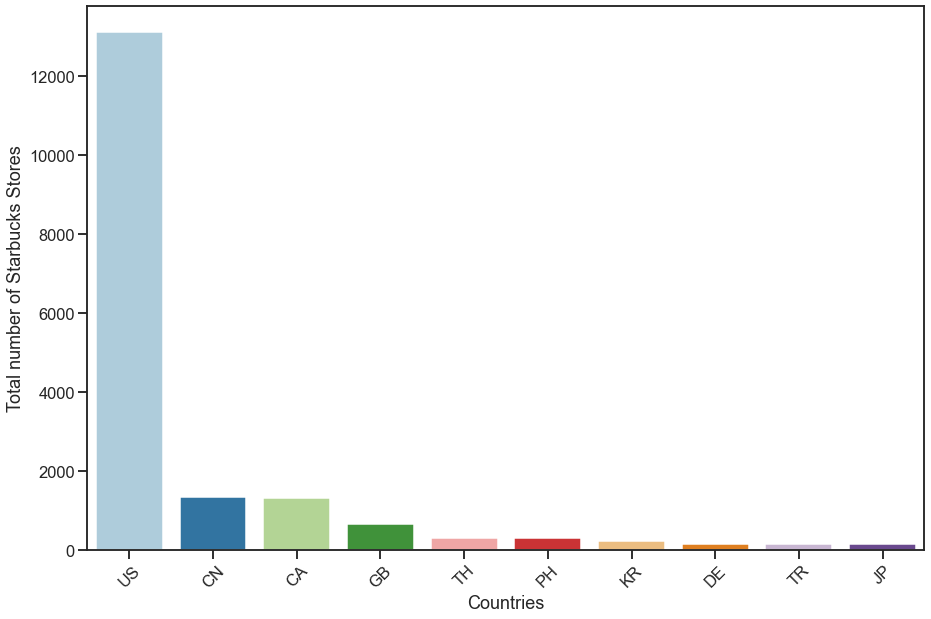

In [180]:
top_fifteen_countries = df_store.country.value_counts().head(10)
country_names =  top_fifteen_countries.index
country_values = top_fifteen_countries.values
plt.figure(figsize=(15,10))
sns.barplot(x=country_names, y=country_values, palette=sns.color_palette('Paired', n_colors=10))
plt.xticks(rotation= 45)
plt.xlabel('Countries')
plt.ylabel('Total number of Starbucks Stores')
country_names = percentage(df_store['country_name'], pd.value_counts)
print(country_names[:10])

After doing this we find that the United States is the country with the most Starbucks holding 70.03% of stores. This is quickly proceeded by China at 7.13%, Canada at 7.01%, United Kingdom of Great Britain and Northern Ireland at 3.52%, Philippines and Thailand at 1.54% and so on. Lets see the breakdown by cities.

#### 8.2. What cities across the world hold the most Starbucks?

Using the percent funtion on the "cities" column in the exact same way as we did for the country saturations section, leads to the expected result. This would have been it for the section, except I got curious. When you run the percent function, we can see it returns several non-latin alphabetic scriptions of cities. We can solve this problem by translating to english language.
Theoretically we could setup a framwork to parse out the non-english text, and translate the other languages (Chinese, Korean, Arabic, etc). However, this is slightly beyond the scope of this notebook. So rather than going too in-depth, let us declare a dictionary containing the the largest foriegn cities in their native languages and the cities english counterpart. We will use this dictionary to better approximate the distribution of starbucks in cities
across the globe. 


In [119]:
city_saturations = percentage(df_store['city'], pd.value_counts)
print(city_saturations[:15])

上海市            1.29
New York       1.23
London         1.02
Toronto        1.01
Chicago        0.94
Seattle        0.80
Houston        0.78
Las Vegas      0.73
北京市            0.72
서울             0.72
San Diego      0.71
Vancouver      0.69
Los Angeles    0.67
Portland       0.60
Calgary        0.58
Name: city, dtype: float64


In [120]:
"""Here we put together the the dictionary and it contains several of the non-english cities and there english counterparts.

non_eng: Dictionary with non-english words and english words as key value pairs
"""
non_eng = {
    
    '上海市': 'Shanghai',
    '北京市': 'Beijing',
    '서울': 'Seoul',
    '杭州市': 'Hangzhou',
    '深圳市': 'Shenzhen',
    '广州市':'Guangzhou',
    '苏州市':'Suzhou',
    '天津市':'Tianjin',
    '张家口':'Zhangjiakou',
    '哈尔滨': 'Harbin',
    'المنامة':'Manama',
    '大连市':'Dalian',
    '长春市':'Changchun',
    '成都市':'Chengdu'
}

####  Starbucks Cities Saturation

In setting this up we pass the "city" column of the DataFrame as the object, and the pandas value counts function as the function. Here because we want the value counts to aggregate the values in the column by unique cities we leave the agg arguement defaulted to false. 

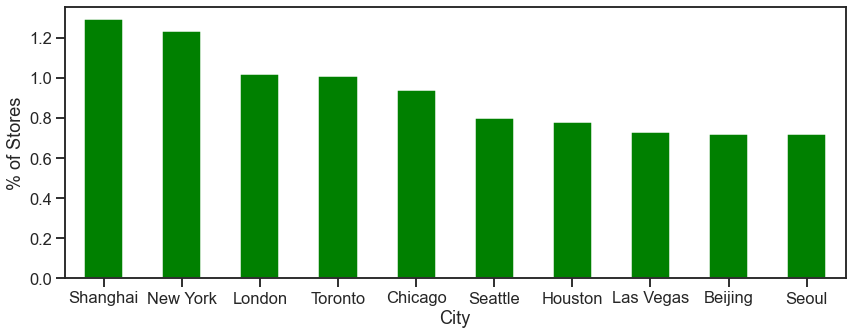

Shanghai     1.29
New York     1.23
London       1.02
Toronto      1.01
Chicago      0.94
Seattle      0.80
Houston      0.78
Las Vegas    0.73
Beijing      0.72
Seoul        0.72
Name: city, dtype: float64


In [122]:
df_store.replace(non_eng,inplace=True)
city_saturations = percentage(df_store['city'], pd.value_counts)
ax = city_saturations[:10].plot(kind='bar',color='green',rot=0,figsize=(14, 5))
ax.set_ylabel('% of Stores')
ax.set_xlabel('City')
plt.show()
print(city_saturations[:10])

After doing some clean up on non-english words, we find that the Shanghai is the city with the most Starbucks holding 1.29% of stores. This is quickly proceeded by New York at 1.23%, London at 1.02%, Toronto at 1.01%, Chicago at 0.94% and so on.

#### 8.3  What States/Province across the world hold the most Starbucks?

Using the percent funtion on the "states" column in the exact same way as we did in the above section, leads to the expected result. Let us check which states contributes more starbucks stores. We will use seaborn library for the colorful graphics. We will take top 10 states from the dataframe to look at.

CA     14.77
TX      5.35
WA      3.94
FL      3.54
NY      3.35
ENG     3.05
IL      2.99
ON      2.68
AZ      2.64
CO      2.49
Name: state_province, dtype: float64


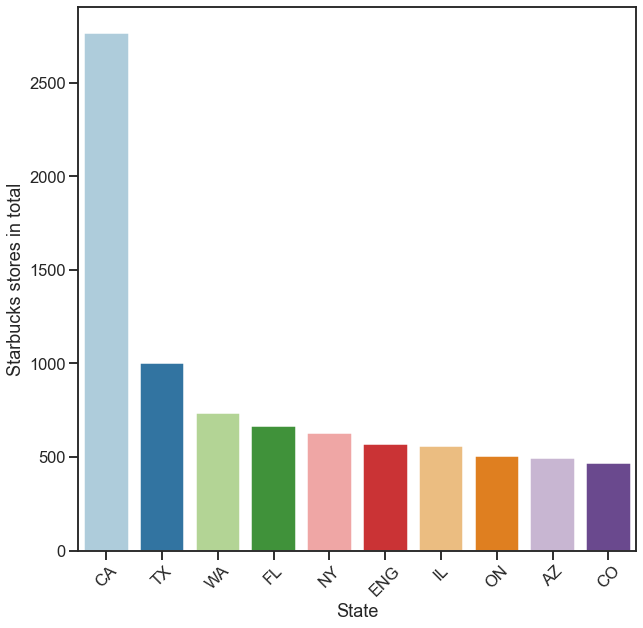

In [198]:
top_fifteen_state = df['state_province'].value_counts().head(10)
state_names =  top_fifteen_state.index
state_values = top_fifteen_state.values
plt.figure(figsize=(10,10))
sns.barplot(x=state_names, y=state_values, palette=sns.color_palette('Paired', n_colors=10))
plt.xticks(rotation= 45)
plt.xlabel('State')
plt.ylabel('Starbucks stores in total');
state_names = percentage(df_store['state_province'], pd.value_counts)
print(state_names[:10])

After looking at the graph we can conclude that the CA is the state with the most Starbucks holding 14.07% of stores. This is quickly proceeded by TX at 5.35%, WA at 3.94%, FL at 3.54%, NY at 3.35% and so on.

#### 8.4. Who owns that Starbucks?

There are several different types of Starbuck's stores that you can buy your unicorn frappichino's at! These different stores can be broken down by ownership type. 

##### Ownership Type

*Company-Owned Stores*

The most common type of Starbucks is the Company-Owned Stores. These are Starbucks which are ran directly by Starbucks Corporate. They follow the most up-to-date practices and procedures and often have the newest drinks. 

*Licensed Stores*

The next type of stores are the Licensed Stores which are independently ran, and abide by most of the same processes as the Company-Owned Starbucks. This is why your drink from a Target Starbucks might taste slightly different than the one at another store (think Target, Kroger, Barne's & Noble, etc.). 

*Joint-Venture Stores*

Another type of store are Joint Venture Stores, which are typically found outside North America and are Starbucks combined with another Company (think a Starbucks inside of a McDonalds).

*Franchise Stores*

The final type of store is the Francise Stores which are identical to Company-owned except that the General Manager is an owner of the store and has stake in its success/failure

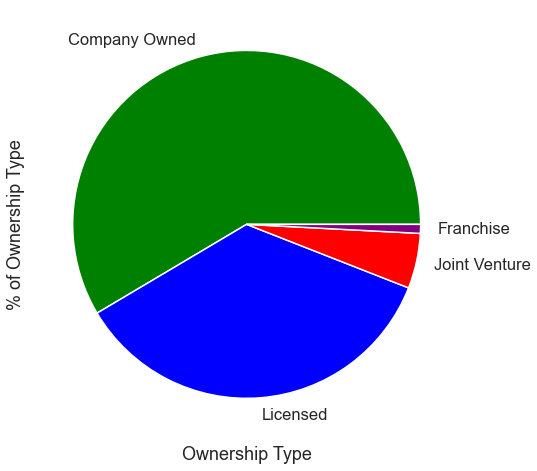

Company Owned    58.52
Licensed         35.52
Joint Venture     5.12
Franchise         0.83
Name: ownership_type, dtype: float64


In [132]:
"""Lets have a look at Ownership type and explore insights
ownership_type: Stores the count of ownership type as a percentage
"""
ownership_type = percentage(df_store["ownership_type"],pd.value_counts)
ax = owner_type.plot(kind='pie',colors=["green", "blue","red","purple"],rot=0,figsize=(8, 8))
ax.set_ylabel('% of Ownership Type')
ax.set_xlabel('Ownership Type')
plt.show()
print(ownership_type)

From the above observation we can conclude that Company Owned Starbucks shops are almost the highest of Ownership percentage with 58.52% followed by Licensed 35.2%, Joint Venture 5.12% and the lowest Franchise 0.83% 

#### A. Joint-Venture Starbucks?

The reason why we see a greater amount of joint-venture stores outside of the US is due to the agglomeration of international food chains in foriegn countries. When you are in China you do have Chinese resteraunts, but rather they are just resteraunts. You do however have American resteraunts and these resteraunts offering American foods often have a tendency to agglomerate together (like a McDonalds, and Starbucks in one store). 

In [123]:
#Chinese and US-only DataFrames
chinese_store = df_store.loc[df_store['country'] == 'CN']
us_store = df_store.loc[df_store['country'] == 'US']

#Ownership-Type by Country
us_own_type = percents(us_store['ownership_type'], pd.value_counts)
cn_own_type = percents(chinese_store['ownership_type'], pd.value_counts)

#Print the Distributions
print('---------------------------------')
print('US Stores')
print(us_own_type)
print('---------------------------------')
print('Chinese Stores')
print(cn_own_type)
print('---------------------------------')

---------------------------------
US Stores
Company Owned    62.28
Licensed         37.72
Name: ownership_type, dtype: float64
---------------------------------
Chinese Stores
Company Owned    54.23
Joint Venture    33.66
Licensed         12.12
Name: ownership_type, dtype: float64
---------------------------------


### 9. Where are these Stores?

In this final section we will use Folium a super simple package that make building maps a very easy process! Here we will build a tool that is fun and useful. We are going to build a tool that will plot a map of every starbucks store.

In [197]:
"""Create a folium map, centered on United States

cor: folium map cordinates
scatter_plot: Takes all the cordinates from latitute and longitude columns which are to be plot on the map  
"""
cor = folium.Map(
    location=[37.6, -95.665],
    zoom_start=4)
scatter_plot = df_store.apply(lambda row: folium.CircleMarker(
    location=[row["latitude"], row["longitude"]], radius=1, weight=3,
    color="#006241", fill_color="#006241").add_to(cor), axis=1)
cor

In [156]:
"""Lets give a try by using plotly library

fig: Takes all the cordinates from latitute and longitude columns which are to be plot on the map 
"""
fig = px.density_mapbox(df_store, lat='latitude', lon='longitude',  radius=5,
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="stamen-terrain")
fig.show()

Based on above observations, we can say that:
 - The city with the most Starbucks is **Shanghai**, followed by New York and London.
 - The countries with the most Starbucks is **United States of America**, followed by China and Canada.
 
 The map seems to confirm these observations.

**Which side of United States has the most Starbucks ? East or west ?** <br>
Let's draw a vertical line on longitude -100.665. All dots on the left of theses lines are west, all on the right are east.

In [199]:
# Divide the dataset between east and west along the longiture -100.665
df_west = df_store[df_store['longitude'] < -100.665]
df_east = df_store[df_store['longitude'] > -100.665]
print("Number of Location in West Side -",df_west.shape[0])
print("Number of Location in East Side -",df_east.shape[0])

Number of Location in West Side - 6141
Number of Location in East Side - 12598


From the above stats we can see that East Side of United States have more number of Starbucks Store i.e. <b>12598</b> as compaired to West side of United States i.e. <b>6141</b>

In [201]:
""" Let us create a map to divide these location in east and west side and we will draw a center line to differentiate.
    We will use folium map to state our visualization
"""
cor = folium.Map(
    location=[37.6, -95.665],
    zoom_start=4
)
scatter_plot = df_east.apply(lambda row: folium.CircleMarker(
    location=[row["latitude"], row["longitude"]], radius=1, weight=3, color="#16697a", 
    fill_color="#16697a").add_to(cor), axis=1)
scatter_plot = df_west.apply(lambda row: folium.CircleMarker(
    location=[row["latitude"], row["longitude"]], radius=1, weight=3, color="#db6400",
    fill_color="#db6400").add_to(cor), axis=1)

# Draw a vertical line on -100.665 longitude
points = [
    [29, -100.665],
    [49, -100.665]
]

folium.PolyLine(points, color="red", weight=2.5, opacity=1).add_to(cor)
cor

From the above graphs it can be clearly stated that East side of United States have more number of Starbucks Location as compaired to West side. 

### 10. Finally storing the cleaned dataframe to an MySQL database

Here we will use mySQL connectors to make an connection to SQL Database. A function name <b>create_connection</b> has been created to make connection and can be used where ever needed. Let us store the dataframe.


In [204]:
def create_connection(hostname, username, userpass):
    """ This function creates a connection with MySQL Database.
    
    connection: Takes mysql.connector parameter to create a connection
    host: Specifies hostname of the database
    user: Specifies hostname of the user
    password: Password of the database
    database: Database in which we want to store the dataframe
    """
    connection = None
    try:
        connection = mysql.connector.connect(
            host = hostname,
            user = username,
            password = userpass,
            database = "starbucksdata",
            auth_plugin='mysql_native_password'
        )
        print("MySQL Database Connected")
    except Error as err:
        print(f"Error:'{err}'")
    return connection

"""Here we can pass the credentials to the function created above.

pw: Password of the Database
connection: Creates connection by taking ip address of machine in which MySQL database needs to be stored.
cursor: Creates a cursor to execute SQL commands
"""
pw = "AI@123"
connection = create_connection("127.0.0.1","root",pw)
cursor = connection.cursor()

MySQL Database Connected


In [221]:
"""We will create a table in "starbucksdata" database specifying all the datatypes of the variables needs to be stored.
Also, "columns" variable is defined to store the column names, which will be used to import the data in SQL Database. 
"""

cursor.execute("CREATE TABLE locations (store_number VARCHAR(255), store_name VARCHAR(255),ownership_type VARCHAR(255),\
street_address VARCHAR(10000),city VARCHAR(255),state_province VARCHAR(255),country VARCHAR(255),postcode VARCHAR(255),\
phone_number VARCHAR(255),longitude INT(255),latitude INT(255),country_name VARCHAR(255))")


columns = ["store_number","store_name","ownership_type","street_address","city","state_province","country",
"postcode","phone_number","longitude","latitude","country_name"]

df_data = df_store[columns] # Declearing new dataframe variable to store the data
df_data = pd.DataFrame(df_data)
df_data = df_data.dropna(axis = 0, how ='any') #Drop any NaN if existed
# creating column list for insertion
cols = "`,`".join([str(i) for i in df_data.columns.tolist()])

# Insert DataFrame recrds one by one.
for i,row in df_data.iterrows():
    sql = "INSERT INTO `locations` (`" +cols + "`) VALUES (" + "%s,"*(len(row)-1) + "%s)"
    cursor.execute(sql, tuple(row))

    # the connection is not autocommitted by default, so we must commit to save our changes
    connection.commit()

### Finally we finished considering all the steps Specified. Thank You!